# 1. Initialization

## 1.1 Load packages

In [1]:
# Import modules for file I/O, data, visualization, math, and graph analysis

using DelimitedFiles      # For reading/writing delimited text files (like CSV, TSV)
using Plots               # For plotting and data visualization
using Colors              # For color utilities used in plots or visual outputs
using Random              # For random number generation
using Statistics          # For basic statistical functions (mean, std, etc.)
using LinearAlgebra       # For matrix operations and linear algebra routines
using Graphs              # For creating and analyzing graph structures
using JLD                 # For reading/writing .jld (Julia data) files
using GLM                 # For fitting generalized linear models (regression)
using DataFrames          # For tabular data manipulation
using DataStructures      # For additional data structures (e.g., heaps, queues, ordered dicts)
using Dates
# Include custom functions from an external file
include("common_functions.jl")

# Set default plotting style: boxed axes and automatic aspect ratio
default(framestyle = :box, aspect_ratio = :auto)

## 1.2 Load the Penrose tiling and make the associated graph objects

In [2]:
NUM_SUBDIVISIONS = 7 # Number of inflations for the Penrose tiling
# NUM_SUBDIVISIONS = 8 for the Penrose tiling used in the paper
# If running to understand the code, you can set this to 6 for faster execution

ngen = NUM_SUBDIVISIONS 
run_no = 1 # Identifier for the current run or simulation, useful for labeling outputs

# === Load tiling and graph structure ===

const ROT = exp(1im * 2 * pi/5)  
# Define a rotation constant: complex 72-degree rotation (used for pentagonal symmetries)

file_name = "./data/center_"  
# Base file path for data files

# --- Load the adjacency matrix for the graph ---
gph = open(readdlm, file_name * string(ngen) * "_graph.txt")  
graph = Array{Int}(undef, size(gph)[1], size(gph)[2])  
# Read in the graph connectivity as a matrix and convert all entries to Int
for i in 1:size(gph, 1)
    for j in 1:size(gph, 2)
        graph[i, j] = Int(gph[i, j])
    end
end

# --- Load coordinates of points making up the tiling ---
pts_x = vec(open(readdlm, file_name * string(ngen) * "_pts_re.txt"))  # x (real) components
pts_y = vec(open(readdlm, file_name * string(ngen) * "_pts_im.txt"))  # y (imaginary) components
pts = [complex(pts_x[i], pts_y[i]) for i in 1:length(pts_x)]  
# Combine x and y into complex numbers representing 2D points

# --- Load index mappings between different components ---
ind_A = round.(Int, vec(open(readdlm, file_name * string(ngen) * "_ind_A.txt")))  # Indices of A-sites
ind_B = round.(Int, vec(open(readdlm, file_name * string(ngen) * "_ind_B.txt")))  # Indices of B-sites

AtoG = round.(Int, vec(open(readdlm, file_name * string(ngen) * "_AtoG.txt")))  # Mapping from A-site index to graph index
BtoG = round.(Int, vec(open(readdlm, file_name * string(ngen) * "_BtoG.txt")))  # Mapping from B-site index to graph index

# --- Load matching and plaquette information ---
max_match = round.(Int, open(readdlm, file_name * string(ngen) * "_max_match.txt"))  # Maximum matching edges
plaq = round.(Int, open(readdlm, file_name * string(ngen) * "_plaq.txt"))            # Plaquette index data

plaq_spins = round.(Int, open(readdlm, file_name * string(ngen) * "_plaq_spins.txt"))  
# Each row encodes four spins making up a plaquette
# Format: [s1, s2, s3, s4], with adjacent spins sharing vertices in a cyclic order:
# s1—s2—s4—s3—s1

# --- Load spin-edge connectivity and monomer data ---
ABedge_no = round.(Int, open(readdlm, file_name * string(ngen) * "_ABedge_no.txt"))  
# Edge numbers between A and B sublattices

spins_to_edges = round.(Int, open(readdlm, file_name * string(ngen) * "_spins_to_edges.txt"))  
# Maps each spin to an edge index

monomer_A = vec(round.(Int, open(readdlm, file_name * string(ngen) * "_monomer_A.txt")))  
# Monomer positions on A sublattice

monomer_B = vec(round.(Int, open(readdlm, file_name * string(ngen) * "_monomer_B.txt")))  
# Monomer positions on B sublattice

# --- Constants derived from the loaded data ---
const nspins = size(spins_to_edges, 1)  # Total number of spins
const npts = size(graph, 1)             # Number of graph nodes (points)
const nplaqs = length(plaq_spins[:,1])  # Number of plaquettes
const ymax = maximum(pts_y)            # Maximum y-coordinate (used for plotting/scaling)

29.0344418537

In [3]:
# === Build neighbor list from adjacency matrix ===

nbrG = []  # Initialize list to store neighbors for each point

for i in 1:npts
    nnn = []  # Temporary list for neighbors of point i
    for j in 1:npts
        if graph[i, j] == 1  # Check if there is an edge between node i and j
            push!(nnn, j)    # Add j to i's list of neighbors
        end
    end
    push!(nbrG, nnn)  # Store neighbor list for point i
end

nbrG = convert_to_int(nbrG)  # Convert neighbor list elements to integers (if not already)

# === Build edge index map between graph nodes using ABedge_no ===

Gedge_no = fill(0, npts, npts)  # Initialize a matrix to store edge numbers between points

for i in 1:npts
    for j in 1:npts
        if graph[i, j] == 1  # Check if i and j are connected
            if ind_A[i] < npts + 5
                # Use ABedge_no with A-site index at i and B-site index at j
                Gedge_no[i, j] = ABedge_no[ind_A[i], ind_B[j]]
            elseif ind_B[i] < npts + 5
                # Use ABedge_no with B-site index at i and A-site index at j (reverse roles)
                Gedge_no[i, j] = ABedge_no[ind_A[j], ind_B[i]]
            else
                println("Error!")  # Handle case where neither condition is satisfied
            end
        end
    end
end

# === Generate spin positions and initialize spin configuration ===

spins_pos = generate_spins_pos()       # Compute physical positions of spins, likely for plotting
config = reset_config(max_match);       # Initialize or reset spin configuration using maximum matching

In [4]:
# === Generate Graph objects representing different physical structures ===

# Create a graph for the Penrose tiling (or similar lattice structure)
# - Nodes are given by 'pts'
# - Edges by the adjacency matrix 'graph'
# - npts: number of points
# - plaq: list of plaquettes
# - nplaqs: number of plaquettes
penrose = Graph(pts, graph, npts, plaq, nplaqs)

# Create a graph representing the spin degrees of freedom
# - Nodes at positions 'spins_pos'
# - Edges defined from adjacency of plaquette spins
# - nspins: total number of spins
# - plaq_spins: spin groupings per plaquette
spins = Graph(spins_pos, generate_spins_adj(plaq_spins, nspins), nspins, plaq_spins, nplaqs)

# Create a graph based on the maximum matching configuration
# - Edges are generated from 'max_match' using geometry of 'penrose'
# - Plaquette info is unused here (set to filler)
dcov = Graph(pts, generate_max_match_adj(max_match, penrose), npts, fill(0, 1, 1), 0)

Graph(ComplexF64[21.0947567836 + 2.6180339887im, 21.6825420359 + 3.4270509831im, 22.0458132999 + 2.9270509831im, 21.0947567836 + 4.2360679775im, 22.6335985522 + 3.7360679775im, 23.5846550685 + 3.4270509831im, 21.0947567836 + 1.6180339887im, 22.0458132999 + 1.3090169944im, 21.6825420359 + 0.8090169944im, 21.0947567836 + 0.0im  …  11.4984349081 - 11.5901699437im, 11.1351636441 - 12.7082039325im, 11.4984349081 - 8.972135955im, 12.0862201604 - 9.7811529494im, 11.4984349081 - 10.5901699437im, 11.1351636441 - 10.0901699437im, 12.0862201604 - 10.7811529494im, 13.0372766767 - 10.0901699437im, 13.0372766767 - 9.472135955im, 12.6740054127 - 8.972135955im], [0 0 … 0 0; 0 0 … 0 0; … ; 0 0 … 0 0; 0 0 … 0 0], 3126, [0;;], 0)

## 1.3 Visualize the tiling and the initial dimer covering

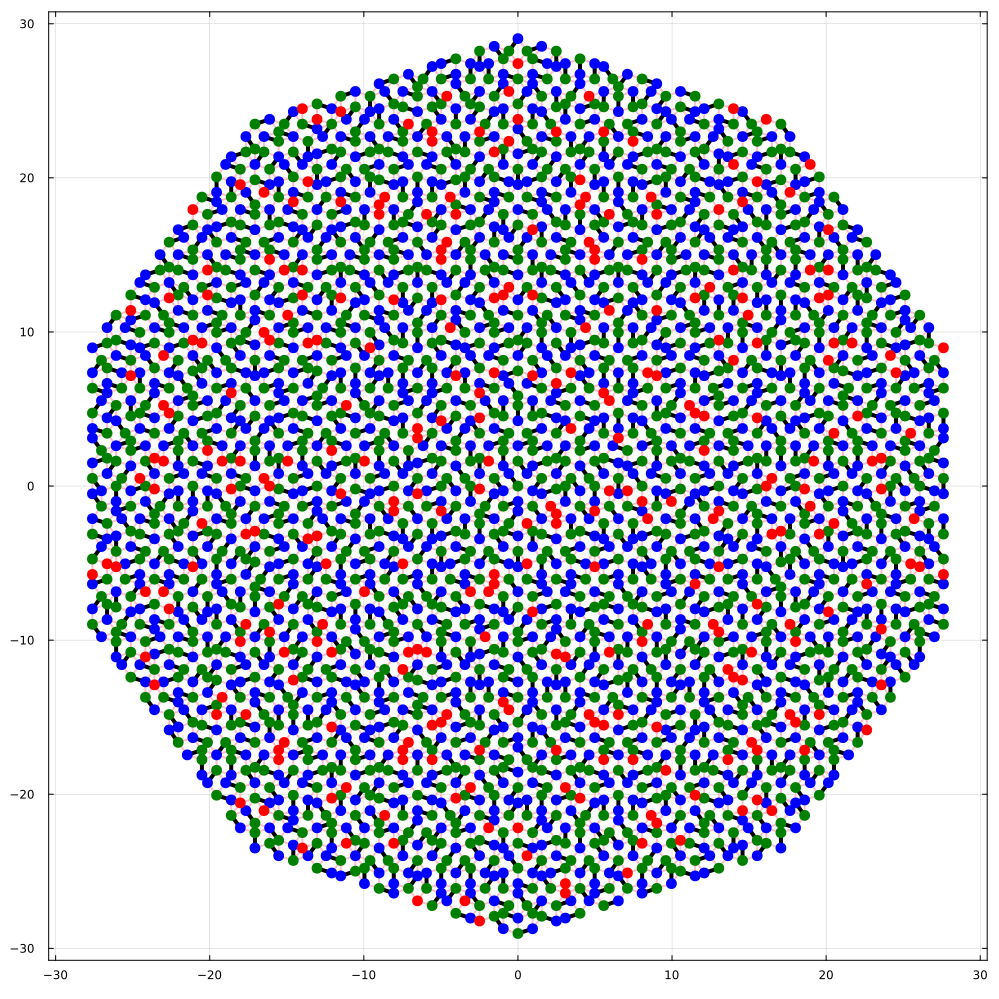

In [6]:
# === Plotting the configuration ===

p = plot_generate(1000)  
# Initialize a plot canvas with size parameter 500 (likely sets resolution or canvas dimensions)

p = plot_edges(p, penrose)  
# Draw the edges of the Penrose tiling (or general lattice) on the plot

p = plot_config(p, config)  
# Overlay the current configuration (e.g., dimers, spins, monomers) onto the plot

display(p)  
# Render and display the final plot

;  

# 2. Monte Carlo | Full lattice

Perfrom Monte Carlo on the full lattice and calculate average dimer occupation of each edge. Use this information to determine the monomer membranes (edges which are never occupied). After the membranes are identified, we will separate the full graph into smaller connected pieces and perform Monte Carlo on individual pieces.

In [7]:
# === Function to calculate the total Sz (proportional to the dimer density) at each edge ===
function sz_correlator(config::Vector{Int64}, running_sum::Vector{Int64}, spin_origin::Int64)
    if config[spin_origin] == 1
        # If the origin spin is up (+1), there is a dimer on that edge of the Penrose tiling 
        # add the configuration vector to the running sum
        for i in eachindex(running_sum)
            running_sum[i] = running_sum[i] + config[i]
        end
    else
        # If the origin spin is down (-1), there is no dimer on that edge of the Penrose tiling 
        # subtract the configuration vector from the running sum
        for i in eachindex(running_sum)
            running_sum[i] = running_sum[i] - config[i]
        end
    end
end

# === Function to add one vector to another in-place ===
# Defining a separate function so that it is fast
function add_vec!(vec1::Vector{Int64}, vec2::Vector{Int64})
    for i in eachindex(vec1)
        vec1[i] = vec1[i] + vec2[i]
    end
end


add_vec! (generic function with 1 method)

In [8]:
# === Attempt a monomer move in the dimer configuration ===
function monomer_move(config::Vector{Int64}, npts::Int64, Gedge_no::Matrix{Int64}, nbrG::Vector{Vector{Int64}})
    initial_site::Int64 = rand(1:npts)  # Randomly select a site
    nbr_initial::Vector{Int64} = nbrG[initial_site]  # Get its neighbors

    # Check if the initial random site is not part of a dimer (i.e., it's a monomer)
    for i in nbr_initial
        if config[Gedge_no[initial_site, i]] == 1 # An dimer exists on the edge connecting initial_site and i
            return false  # Site is part of a dimer; not a monomer
        end
    end

    # Site is a monomer — attempt to move it
    special_nbr::Int64 = rand(nbr_initial)  # Choose a random neighbor to move toward
    nnbr::Vector{Int64} = nbrG[special_nbr]  # Get neighbors of that neighbor

    for i in nnbr
        if config[Gedge_no[i, special_nbr]] == 1  # Look for a dimer adjacent to the neighbor
            config[Gedge_no[i, special_nbr]] = -1  # Remove old dimer
            config[Gedge_no[initial_site, special_nbr]] = 1  # Add new dimer linking initial monomer site
            return true  # Move successful
        end
    end
    return false  # No valid move found
end

# === Attempt a plaquette flip move (resonance/ring exchange) in the configuration ===
function plaq_move(config::Vector{Int64}, nplaqs::Int64, plaq_spins::Matrix{Int64})
    random_plaq = rand(1:nplaqs)  # Randomly select a plaquette

    # Extract the four spins (edges) forming the plaquette
    s1 = plaq_spins[random_plaq, 1]
    s2 = plaq_spins[random_plaq, 2]
    s3 = plaq_spins[random_plaq, 3]
    s4 = plaq_spins[random_plaq, 4]

    # Flippable configuration 1: if dimers occupy s1 and s4, flip to s2 and s3
    if config[s1] == 1 && config[s4] == 1
        config[s1] = -1
        config[s4] = -1
        config[s2] = 1
        config[s3] = 1
        return true  # Flip successful

    # Flippable configuration 2: if dimers occupy s2 and s3, flip to s1 and s4
    elseif config[s2] == 1 && config[s3] == 1
        config[s2] = -1
        config[s3] = -1
        config[s1] = 1
        config[s4] = 1
        return true  # Flip successful
    end

    return false  # No valid plaquette flip
end

plaq_move (generic function with 1 method)

In [9]:
# === Main Monte Carlo code to measure ⟨Sz⟩ and Sz-Sz correlators without averaging over origins ===
function mc_mobile_full_no_avg(mc_steps::Int64, Nmix::Int64, config::Vector{Int64},
                               plaq_spins::Matrix{Int64}, spin_origin::Int64,
                               Gedge_no::Matrix{Int64}, nbrG::Vector{Vector{Int64}})
    
    nplaqs::Int64 = size(plaq_spins, 1)     # Number of plaquettes
    nspins::Int64 = length(config)          # Total number of spins

    sz_corr_array::Vector{Int64} = fill(0, nspins)  # Accumulator for Sz-Sz correlator from spin_origin
    sz_avg::Vector{Int64} = fill(0, nspins)         # Accumulator for average ⟨Sz⟩ across configurations

    # === Main Monte Carlo sampling loop ===
    for i in 1:mc_steps
        # Perform Nmix rounds of local updates before measurements
        for j in 1:Nmix
            while !monomer_move(config, npts, Gedge_no, nbrG)
                # Attempt monomer move until successful
            end
            while !plaq_move(config, nplaqs, plaq_spins)
                # Attempt plaquette flip until successful
            end
        end

        # Accumulate ⟨Sz⟩ and Sz-Sz correlator measurements
        add_vec!(sz_avg, config)
        sz_correlator(config, sz_corr_array, spin_origin)
    end

    # Normalize by number of Monte Carlo steps
    sz_corr_array_float = sz_corr_array / mc_steps
    sz_avg_float = sz_avg / mc_steps

    return sz_avg_float, sz_corr_array_float  # Return ⟨Sz⟩ and ⟨Sz_origin Sz_i⟩
end

mc_mobile_full_no_avg (generic function with 1 method)

In [10]:
# === Set Monte Carlo parameters and run the simulation ===

mc_steps = 20_000  # Total number of Monte Carlo steps (e.g., 20,000)
Nmix = 100                # Number of update steps between measurements (thermalization/mixing)
spin_origin = 300         # Index of the spin used as the correlation reference point

config = reset_config(max_match)  
# Initialize the spin configuration using the maximum matching (dimer configuration)

# Run the Monte Carlo loop and measure observables
@time sz_disg, szsz_disg = mc_mobile_full_no_avg(
    mc_steps,              # Number of MC steps
    Nmix,                  # Number of mixing steps per measurement
    config,                # Initial spin/dimer configuration
    plaq_spins,            # Plaquette spin structure
    spin_origin,           # Spin origin for Sz-Sz correlator
    Gedge_no,              # Mapping from graph edges to spin indices
    convert_to_int(nbrG)   # Neighbor list with integer values
)
;

  0.999808 seconds (6.45 k allocations: 708.906 KiB, 1.13% compilation time)


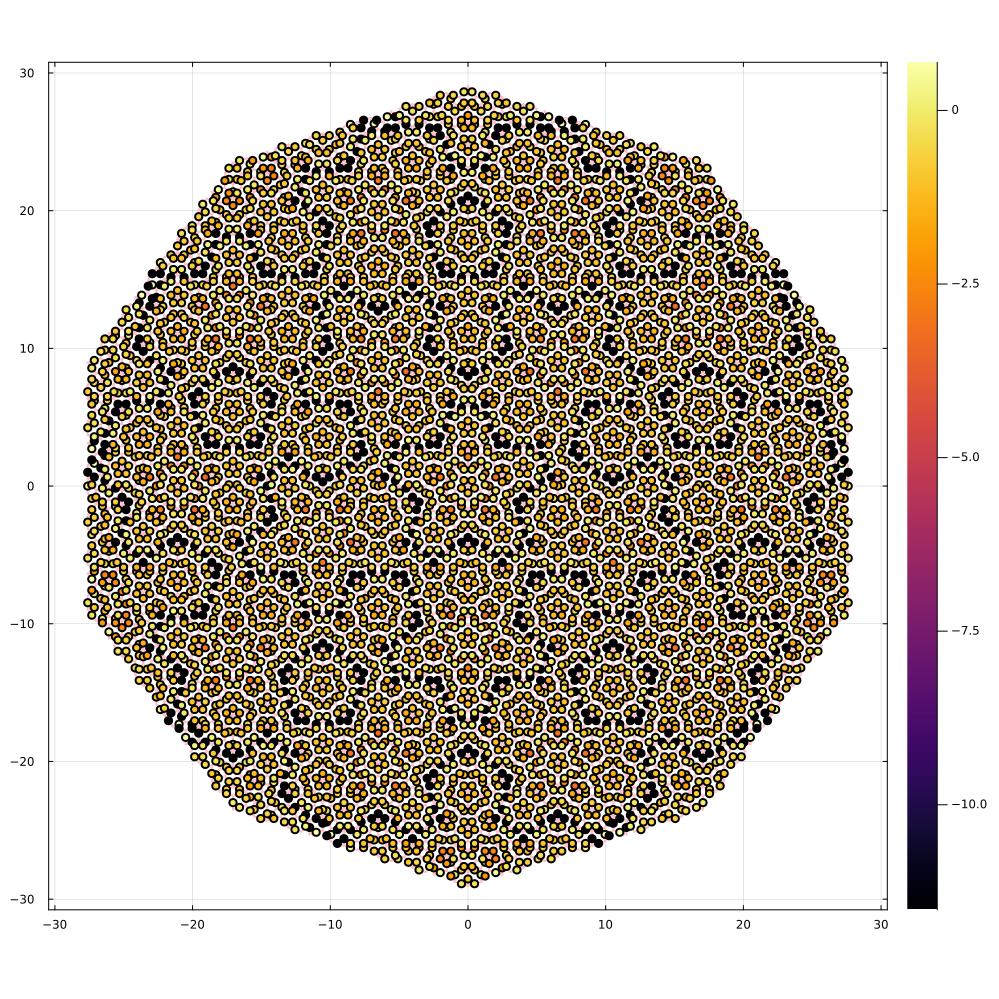

In [12]:
# === Visualize the monomer membranes using Sz expectation values ===

p = plot_generate(1000)  
# Initialize the plotting canvas with size parameter 500

p = plot_edges(p, penrose)  
# Draw the lattice (e.g., Penrose tiling) edges as a background

p = plot_sz(p, spins, log.(abs.(sz_disg .+ 1.0 .+ 1e-5)))  
# Plot the spin expectation values ⟨Sz⟩
# Apply log scale for better contrast and numerical stability:
# - Shift by +1.0 to center values
# - Add small 1e-5 to avoid log(0)

plot!(colorbar = true)  
# Add a colorbar to the plot

display(p) ;

# 3. Generate disconnected graph

In [13]:
# === Identify monomer membrane edges from Sz data ===
function get_monomer_membranes_numerics(sz)
    membrane_edges = []

    for i in 1:nspins
        if abs(sz[i] + 1.0) < 1e-3
            # Spin is strongly polarized at Sz ≈ -1, indicating part of a membrane
            a, b = spins_to_edges[i, :]         # Get A/B spin indices connected by this edge
            push!(membrane_edges, [AtoG[a], BtoG[b]])  # Convert to graph vertex indices and store
        end
    end

    return convert_to_int(membrane_edges)  # Ensure indices are integers
end

# === Create a new graph with membrane edges removed ===
function generate_disconnected_graph(sz)
    # Create a deep copy of the original Penrose graph
    disg = Graph(copy(pts), copy(graph), copy(npts), copy(plaq), copy(nplaqs))

    # Identify edges that correspond to monomer membranes
    monomer_membrane = get_monomer_membranes_numerics(sz)

    # Remove these edges from the adjacency matrix
    for i in monomer_membrane
        p1, p2 = i
        disg.adj[p1, p2] = 0
        disg.adj[p2, p1] = 0
    end

    return disg  # Return the disconnected graph
end

generate_disconnected_graph (generic function with 1 method)

In [14]:
monomer_membrane = get_monomer_membranes_numerics(sz_disg);
# === Analyze connectivity after removing monomer membranes ===

disg = generate_disconnected_graph(sz_disg)  
# Generate a new graph where membrane edges (Sz ≈ -1) have been removed

g = SimpleGraph(disg.adj)  
# Convert the (symmetric) adjacency matrix to a SimpleGraph object from Graphs.jl

ccg = connected_components(g)  
# Compute the list of connected components in the modified graph

;  # Suppress output

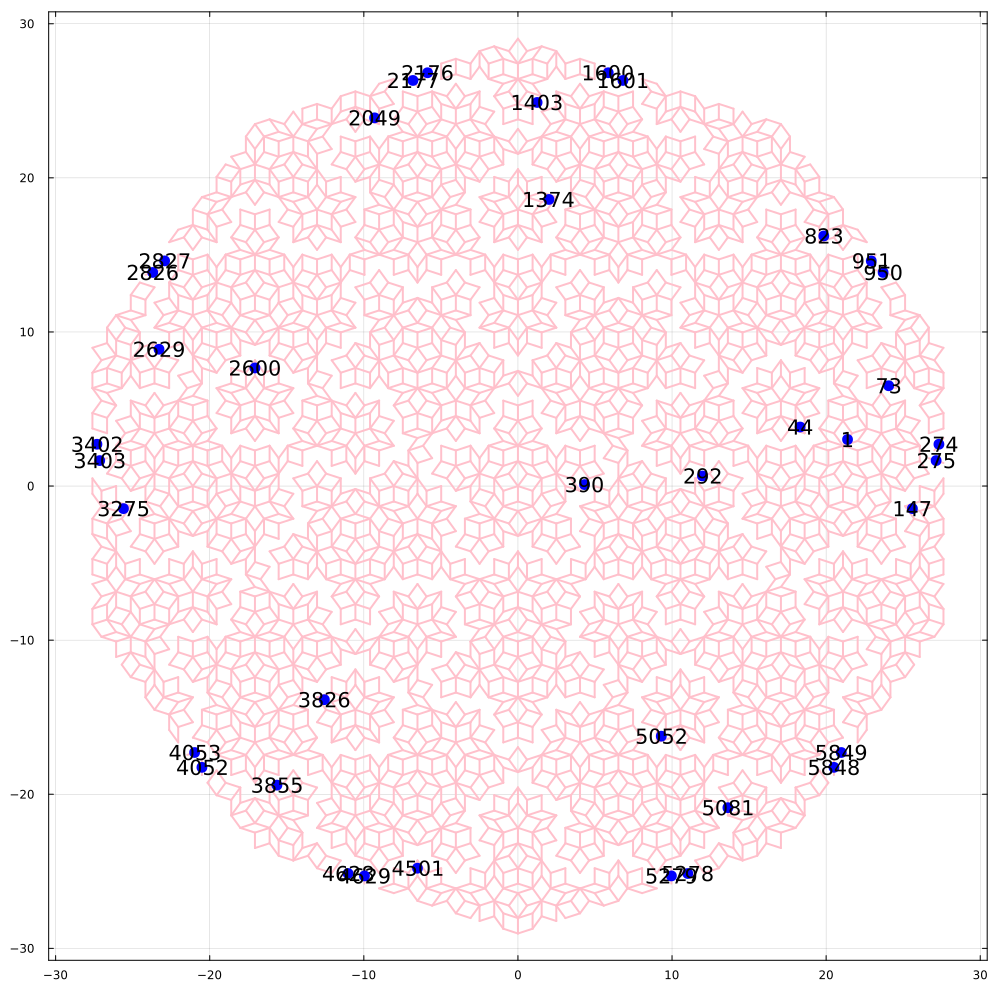

In [15]:
# === Visualize connected components after membrane disconnection ===

disg = generate_disconnected_graph(sz_disg)  
# Create a graph with monomer membrane edges removed (based on Sz ≈ -1)

p = plot_generate(1000)  
# Initialize plot canvas at higher resolution (e.g., 1000 units)

p = plot_edges(p, disg)  
# Draw the edges of the disconnected graph

# Optional: Uncomment to overlay all spin sites
# p = plot_sites(p, spins, :blue, 0; annotate = false, markersize=2)

# For each connected component, find and annotate one representative spin position
for i in 1:length(ccg)
    j = -1
    # Find a neighbor of the first node in the component to identify an edge
    for k in 1:disg.n
        if disg.adj[ccg[i][1], k] == 1
            j = k
            break
        end
    end

    spin_number = Gedge_no[ccg[i][1], j]  # Map edge to spin index
    point = spins_pos[spin_number]       # Get 2D position of that spin

    # Mark the spin's location on the plot
    scatter!(p,
        [real(point)], [imag(point)],
        mc = :blue,                      # Marker color
        markerstrokewidth = 0,          # No border
        series_annotations = string(spin_number),  # Optional label
        label = "",                     # Do not show in legend
        markersize = 6
    )
end

display(p)  # Show the plot
;

## 3.1 Set spin origin to select a connected piece

In [16]:
# === SETTING SPIN ORIGIN FOR CORRELATION MEASUREMENT ===
# ###########################################################################################################

# Spin origins for different generations:

# Different regions for ngen=8: 921, 707, 1
# Different regions for ngen=7: 390, 292, 1

# Set the spin origin index here:
spin_origin = 1  # Current setting: Region R2 for ngen = 8

# Notes for paper figures:
# - Region R2 (paper’s R1): spin_origin = 1
# - Region R3 (paper’s R2): spin_origin = 707

# ###########################################################################################################

1

## 3.2 Generate subgraph

In [17]:
# === Identify the sublattice connected to the selected spin_origin ===

sub_lat = 0  # Will hold indices of sublattice vertices

# Get endpoints of the spin (edge) corresponding to the spin_origin
a, b = spins_to_edges[spin_origin, :]
p1 = AtoG[a]  # Convert to graph vertex index
p2 = BtoG[b]

# Find the connected component that contains both endpoints
for i in 1:length(ccg)
    if p1 in ccg[i] && p2 in ccg[i]
        sub_lat = ccg[i]
        break
    end
end

# Log size and indices of the sublattice
println(length(sub_lat))
println(sub_lat)

# === Initialize sublattice point list and lookup mapping ===

sub_npts = length(sub_lat)
sub_pts = [pts[sub_lat[i]] for i in 1:sub_npts]  # Coordinates of sublattice points

lat_to_sublat = fill(0, npts)  # Map full lattice indices to sublattice indices
for i in 1:sub_npts
    lat_to_sublat[sub_lat[i]] = i
end

# === Build sublattice edge and spin graph ===

sub_spins = Int64[]  # Store spin indices associated with edges in the subgraph
sub_graph = fill(0, (sub_npts, sub_npts))  # Adjacency matrix of the subgraph

sub_spins_to_full_spins = fill(0, nspins)  # Map full spin index to sub spin index
sub_spins_lat_mat = fill(0, sub_npts, sub_npts)  # Map between subgraph vertices and spin index

# Extract all edges (spins) within the subgraph
for i in 1:sub_npts-1
    for j in i+1:sub_npts
        if graph[sub_lat[i], sub_lat[j]] == 1
            sub_graph[i,j] = 1
            sub_graph[j,i] = 1
            push!(sub_spins, Gedge_no[sub_lat[i], sub_lat[j]])
            sub_spins_to_full_spins[Gedge_no[sub_lat[i], sub_lat[j]]] = length(sub_spins)
            sub_spins_lat_mat[i,j] = length(sub_spins)
            sub_spins_lat_mat[j,i] = length(sub_spins)
        end
    end
end

# === Generate spin positions for the subgraph ===

sub_spins_to_edges = fill(0, 2, length(sub_spins))  # Maps each sub spin to its vertex pair
count = 1
for i in 1:sub_npts-1
    for j in i+1:sub_npts
        if graph[sub_lat[i], sub_lat[j]] == 1
            sub_spins_to_edges[1, count] = i
            sub_spins_to_edges[2, count] = j
            count += 1
        end
    end
end

sub_spins_pos = ComplexF64[]  # 2D position of sub spins
for i in 1:length(sub_spins)
    push!(sub_spins_pos, spins_pos[sub_spins[i]])
end

# === Extract plaquettes composed entirely of sub spins ===

sub_plaq = []
for i in 1:size(plaq_spins, 1)
    s1, s2, s3, s4 = plaq_spins[i, :]
    if s1 in sub_spins && s2 in sub_spins && s3 in sub_spins && s4 in sub_spins
        push!(sub_plaq, [sub_spins_to_full_spins[s1], sub_spins_to_full_spins[s2], 
                         sub_spins_to_full_spins[s3], sub_spins_to_full_spins[s4]])
    end
end

# Convert list of plaquettes to matrix form
sub_plaq_temp = fill(0, length(sub_plaq), 4)
for i in 1:length(sub_plaq)
    for j in 1:4
        sub_plaq_temp[i,j] = sub_plaq[i][j]
    end
end
sub_plaq = sub_plaq_temp

# === Create adjacency matrix for spins based on shared plaquettes ===

sub_nspins = length(sub_spins)
sub_nplaq = size(sub_plaq, 1)
sub_spins_graph2 = fill(0, sub_nspins, sub_nspins)

for i in 1:sub_nplaq
    s1, s2, s3, s4 = sub_plaq[i, :]
    sub_spins_graph2[s1, s3] = 1
    sub_spins_graph2[s1, s2] = 1
    sub_spins_graph2[s3, s4] = 1
    sub_spins_graph2[s4, s2] = 1
    sub_spins_graph2[s3, s1] = 1
    sub_spins_graph2[s2, s1] = 1
    sub_spins_graph2[s4, s3] = 1
    sub_spins_graph2[s2, s4] = 1
end

# === Construct spin-spin adjacency matrix based on full graph structure ===

sub_spins_graph = fill(0, sub_nspins, sub_nspins)
for i in 1:nspins
    if sub_spins_to_full_spins[i] > 0
        for j in 1:nspins
            if spins.adj[i,j] == 1 && sub_spins_to_full_spins[j] > 0
                s_i = sub_spins_to_full_spins[i]
                s_j = sub_spins_to_full_spins[j]
                sub_spins_graph[s_i, s_j] = 1
                sub_spins_graph[s_j, s_i] = 1
            end
        end
    end
end

# === Construct subgraph objects ===

sub_penrose = Graph(sub_pts, sub_graph, sub_npts, fill(0,1,1), size(sub_plaq, 1))
sub_penrose_spin = Graph(sub_spins_pos, sub_spins_graph, length(sub_spins_pos), sub_plaq, size(sub_plaq, 1))

# === Generate spin neighbor lists for each vertex in the subgraph ===

sub_lat_nbr_spin = []
sub_penrose_nbr = get_sub_neighbors(sub_penrose)
for i in 1:sub_penrose.n
    temp = []
    for neighbor in sub_penrose_nbr[i]
        append!(temp, sub_spins_lat_mat[i, neighbor])
    end
    push!(sub_lat_nbr_spin, temp)
end

sub_lat_nbr_spin = convert_to_int(sub_lat_nbr_spin)
;

1520
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 16, 21, 22, 23, 24, 25, 26, 28, 29, 32, 33, 34, 44, 49, 50, 52, 53, 54, 55, 56, 57, 58, 59, 62, 63, 68, 69, 70, 71, 72, 73, 74, 75, 85, 88, 98, 101, 102, 108, 111, 112, 117, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 135, 136, 137, 139, 140, 143, 144, 145, 146, 156, 159, 160, 165, 166, 168, 169, 170, 171, 172, 173, 174, 175, 195, 196, 199, 200, 201, 223, 227, 230, 235, 236, 237, 238, 239, 240, 247, 257, 258, 261, 262, 263, 264, 273, 276, 277, 282, 283, 285, 286, 287, 288, 289, 290, 291, 292, 293, 294, 295, 296, 297, 298, 299, 300, 301, 303, 304, 305, 306, 307, 308, 309, 310, 311, 312, 313, 315, 318, 319, 320, 322, 324, 325, 329, 332, 333, 334, 335, 336, 337, 338, 339, 340, 341, 342, 343, 344, 345, 346, 347, 348, 349, 350, 351, 354, 358, 359, 360, 361, 362, 363, 365, 366, 368, 369, 370, 377, 380, 381, 382, 383, 384, 385, 386, 387, 390, 391, 396, 397, 398, 399, 400, 401, 402, 403, 413, 416, 426, 429, 430, 436, 439, 440, 445, 45

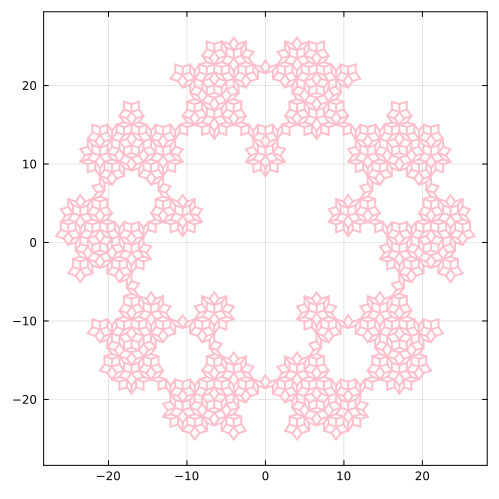

In [18]:
# === Plot the extracted sub-Penrose lattice ===

p = plot_generate(500)             # Initialize the plot with resolution 500
p = plot_edges(p, sub_penrose)     # Draw the edges of the subgraph onto the plot

# 4. Generate paths

## 4.1 Vison paths

In [19]:
# === Map each spin to the plaquettes it participates in ===

spin_to_plaq = []  # List of plaquette indices for each spin

for i in 1:sub_penrose_spin.n
    temp = []
    for j in 1:size(sub_penrose_spin.plaq, 1)
        if i in sub_penrose_spin.plaq[j, :]
            push!(temp, j[1])  # Record plaquette index that includes this spin
        end
    end
    push!(spin_to_plaq, temp)
end

spin_to_plaq = convert_to_int(spin_to_plaq)  # Ensure integer encoding
cplaq = length.(spin_to_plaq)  # Number of plaquettes per spin

# === Build neighbor list from the spin adjacency graph ===

sub_spins_graph_nbr = []

for i in 1:sub_nspins
    temp = []
    for j in 1:sub_nspins
        if sub_spins_graph[i, j] == 1
            push!(temp, j)  # j is a neighbor of i
        end
    end
    push!(sub_spins_graph_nbr, temp)
end

# === Construct extended neighborhood for vison correlator calculation ===

vison_spins_graph_nbr = []

for i in 1:sub_nspins
    temp = []
    pq = spin_to_plaq[i]  # All plaquettes spin i belongs to

    # For each plaquette, collect all spins in that plaquette
    for pl in pq
        temp = vcat(temp, sub_plaq[pl, :])
    end

    temp = unique(temp)              # Remove duplicates
    filter!(e -> e ≠ i, temp)        # Exclude self from neighborhood
    push!(vison_spins_graph_nbr, temp)
end

# Ensure that graph neighbors are also included in vison neighborhood
for i in 1:length(sub_spins_graph_nbr)
    for xx in sub_spins_graph_nbr[i]
        if !(xx in vison_spins_graph_nbr[i])
            push!(vison_spins_graph_nbr[i], xx)
        end
    end
end

vison_spins_graph_nbr = convert_to_int(convert_to_int(vison_spins_graph_nbr))
;

spin_cno = sum(sub_penrose_spin.adj, dims=1)
;

In [20]:
# === Generate a valid path through spins based on plaquette visitation constraints ===
function get_good_path(
    src::Int64,                        # Starting spin index
    len::Int64,                        # Desired path length
    spin_cno::Matrix{Int64},          # Spin connectivity (degree), currently unused
    vison_spins_graph_nbr::Vector{Vector{Int64}},  # Neighboring spins for vison graph
    spins_to_plaqs::Vector{Vector{Int64}},         # List of plaquettes each spin belongs to
    sub_nplaq::Int64,                 # Total number of plaquettes
    Ntries::Int64 = 10                # Max attempts per step
)
    path = [src]  # Start path with source spin
    plaq_visited = fill(0, sub_nplaq)  # Track number of visits to each plaquette

    # Mark plaquettes connected to the starting spin as visited
    for i in spins_to_plaqs[src]
        plaq_visited[i] += 1
    end

    # Try to extend the path up to Ntries steps
    for i in 1:Ntries
        if len < 0
            return path  # Stop if target length already reached
        end

        next_pt = 0  # Candidate for the next point in the path

        # Iterate over shuffled neighbors of the current spin
        for j in shuffle(vison_spins_graph_nbr[path[end]])
            if j in path
                continue  # Avoid revisiting spins (no loops)
            end

            plaqs = spins_to_plaqs[j]

            # Rule 1: Single plaquette spin, not already visited more than once
            if length(plaqs) == 1 && plaq_visited[plaqs[1]] <= 1
                push!(path, j)
                len -= 1
                plaq_visited[plaqs[1]] += 1
                break

            # Rule 2: Two-plaquette spin, where only one has been visited
            elseif length(plaqs) == 2 && (
                (plaq_visited[plaqs[1]] == 0 && plaq_visited[plaqs[2]] == 1) ||
                (plaq_visited[plaqs[1]] == 1 && plaq_visited[plaqs[2]] == 0)
            )
                push!(path, j)
                len -= 1
                plaq_visited[plaqs[1]] += 1
                plaq_visited[plaqs[2]] += 1
                break
            end
        end
    end
    return path
end

# === Try multiple paths from a source and return the longest valid one ===
function get_good_path_maxl(
    src::Int64,                       # Starting spin
    len::Int64,                       # Target path length
    spins_to_plaqs::Vector{Vector{Int64}},  # Plaquette mapping for each spin
    sub_nplaq::Int64,                # Total number of plaquettes
    vison_spins_graph_nbr::Vector{Vector{Int64}},  # Spin neighbors (vison graph)
    Ntries,                          # Attempts per path
    Nsamp = 1000                     # Number of sampled paths
)
    spin_cno = sum(sub_penrose_spin.adj, dims=1)  # Degree of each spin (not used)
    list_paths = []

    # Sample Nsamp paths
    for i in 1:Nsamp
        new_path = get_good_path(src, len, spin_cno, vison_spins_graph_nbr, spins_to_plaqs, sub_nplaq, Ntries)
        push!(list_paths, new_path)
        if length(new_path) == len
            break  # Early exit if a full-length path is found
        end
    end

    # Return the longest path found
    mxval, mxindex = findmax(length.(list_paths))
    return list_paths[mxindex]
end

# === Generate all 10 symmetric copies (5 rotations × 2 reflections) of a path ===
function generate_symm_path(
    path::Vector{Int64},     # Original spin path
    pts::Vector{ComplexF64}  # Positions of spins
)
    symm_path = []

    for i in 0:4
        curr_path = []
        curr_path_r = []

        for j in path
            symm_pt = ROT^i * pts[j]                   # Rotate point
            symm_pt_r = reflectY(ROT^i * pts[j])       # Reflect rotated point

            push!(curr_path, pos_to_spin_index(symm_pt, pts))     # Map to spin index
            push!(curr_path_r, pos_to_spin_index(symm_pt_r, pts)) # Map reflected point to spin index
        end

        push!(symm_path, curr_path)
        push!(symm_path, curr_path_r)
    end

    return transp(convert_to_matrix_int(symm_path))  # Return as matrix, each column a path
end

generate_symm_path (generic function with 1 method)

In [21]:
# === Build a reverse lookup: from each spin to the plaquettes it belongs to ===

spins_to_plaqs = [[] for i in 1:sub_nspins]  
# Initialize an empty list for each spin to hold its associated plaquette indices

for i in 1:sub_nplaq
    for j in sub_penrose_spin.plaq[i, :]
        push!(spins_to_plaqs[j], i)  
        # For each spin j in plaquette i, record that spin j is part of plaquette i
    end
end

In [22]:
# === Map each spin to the plaquettes it belongs to ===

spins_to_plaqs = [[] for i in 1:sub_nspins]  # Initialize an empty list for each spin

for i in 1:sub_nplaq
    for j in sub_penrose_spin.plaq[i, :]
        push!(spins_to_plaqs[j], i)  # Record that spin j is in plaquette i
    end
end

spins_to_plaqs = convert_to_int(spins_to_plaqs)  # Ensure all entries are integers


2705-element Vector{Vector{Int64}}:
 [1, 2]
 [1, 3]
 [4, 5]
 [3, 4]
 [6, 7]
 [5, 6]
 [2, 7]
 [2, 8]
 [1, 8]
 [1, 12]
 ⋮
 [1178, 1179]
 [1180]
 [1174, 1180]
 [1139, 1180]
 [1139]
 [1175, 1180]
 [1175, 1177]
 [1177, 1179]
 [1179]

In [23]:
# === Generate multiple valid paths for vison correlator computation ===

npaths = 500        # Total number of paths to generate
lpath = 40          # Target length of each path
paths = Vector{Int64}[]  # Container to store all valid paths

for i in 1:npaths
    pp = []

    while true
        # Try generating a path from a random starting spin
        pp = get_good_path_maxl(
            rand(1:sub_penrose_spin.n),  # Random source spin
            lpath,                       # Desired path length
            spins_to_plaqs,              # Spin-to-plaquette map
            sub_nplaq,                   # Total number of plaquettes
            vison_spins_graph_nbr,       # Extended spin neighbor graph
            3 * lpath,                   # Max tries per path
            1000                         # Number of samples
        )

        # Accept path only if it's nontrivial (more than 2 sites)
        if length(pp) > 2
            break
        end
    end

    push!(paths, pp)
end

In [24]:
# === Print lengths of generated paths for diagnostic purposes ===
l_paths = [length(paths[i]) for i in 1:length(paths)]
println(l_paths)

[42, 42, 42, 42, 42, 42, 42, 42, 42, 40, 42, 42, 40, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 40, 40, 42, 42, 42, 40, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 40, 42, 42, 42, 40, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 40, 42, 42, 42, 42, 42, 42, 42, 40, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 40, 42, 42, 42, 42, 40, 42, 42, 42, 42, 42, 40, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 40, 42, 42, 40, 40, 40, 42, 42, 42, 42, 42, 42, 42, 41, 42, 42, 42, 42, 42, 40, 42, 42, 42, 41, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 40, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 40, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 40, 40, 42, 42, 42, 42, 42, 42, 42, 42, 40, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 40, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 40, 42, 42, 41, 42, 42, 42, 42, 40, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42, 42,

In [25]:
# === Generate symmetry-related copies of all valid paths ===

mega_path::Vector{Matrix{Int64}} = [
    generate_symm_path(pth, sub_penrose_spin.pts) for pth in paths
];
println(size.(mega_path))

[(42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (40, 10), (42, 10), (42, 10), (40, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (40, 10), (40, 10), (42, 10), (42, 10), (42, 10), (40, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (40, 10), (42, 10), (42, 10), (42, 10), (40, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (40, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (40, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (40, 10), (42, 10), (42, 10), (42, 10), (42, 10), (40, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (40, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10), (42, 10),

In [26]:
# === Plot a few symmetric vison paths on the sublattice ===

for j in 1:5
    siz = 1000
    p = plot(size = (siz, siz), aspect_ratio = :equal, legend = false)
    # Initialize the plot with fixed size and no legend; axes are equal for geometry preservation

    plot_edges(p, sub_penrose)  
    # Draw the edges of the sub-Penrose lattice

    plot_sites(p, sub_penrose_spin, :blue, 6; annotate=false, markersize=0)
    # Overlay spin sites (optional, with zero marker size to preserve graph structure)

    sub_plot_path(p, mega_path[j][:, 3])
    # Plot the j-th generated path's 3rd symmetric variant

    savefig(p, "./images/test_vison_paths" * string(j) * ".png")
    # Save the resulting figure to the specified directory with an indexed filename

    # display(p)  # Uncomment if you want to view the plots interactively
end

## 4.2 Monomer Wilson loops and lines

In [32]:

# Generate a monomer path that may return a non-trivial loop
function generate_monomer_path(l::Int64, sub_nbrG::Vector{Vector{Int64}}, Ntries::Int64 = 100)
    npts = sub_penrose.n
    start = rand(1:npts)                          # Start at a random vertex
    path = [start, rand(sub_nbrG[start])]         # Start with two connected points

    for i in 1:Ntries
        current_pt = path[end]
        previous_pt = path[end-1]
        rnbr = shuffle(sub_nbrG[current_pt])      # Random neighbor order
        for next_pt in rnbr
            if next_pt != previous_pt
                if next_pt in path
                    # Loop detected — extract the closed part
                    push!(path, next_pt)
                    temp = [pop!(path)]
                    while length(path) > 0
                        new_pt = pop!(path)
                        if new_pt == next_pt
                            return temp           # Return the closed loop
                        else
                            push!(temp, new_pt)
                        end
                    end
                    return path                   # Fallback return
                else
                    push!(path, next_pt)          # Continue building the path
                    break
                end
            end
        end
        if length(path) >= l
            return []                             # Give up if path too long
        end
    end
    return []
end

# Split a loop in half into two subpaths
function split_loop(loop)
    len = length(loop)
    return [loop[1:len ÷ 2], loop[len÷2 + 1:end]]
end

# Check whether any site in a path is on the boundary (only appears in one plaquette)
function boundary_path_check(path, spin_graph)
    for sp in path
        count = 0
        for j in 1:spin_graph.nplaq
            if sp in sub_penrose_spin.plaq[j,:]
                count += 1
            end
        end
        if count == 1
            return true
        end
    end
    return false
end


# Generate a basis of monomer paths of various lengths
function generate_mbasis(sub_penrose::Graph)
    lval = [4, 6, 8, 10, 12, 14, 16, 18, 20]      # Loop lengths
    basis = [[] for i in 1:length(lval)]          # Store paths grouped by length

    np = 2000                                     # Number of paths per length
    counter = 0
    nbrG_sub_penrose = get_nbrG(sub_penrose)

    while counter < 400 * 10                      # Try for many samples
        curr = generate_monomer_path(100, nbrG_sub_penrose, 200)
        if minimum(lval) <= length(curr) <= maximum(lval)
            ind = (length(curr) - lval[1]) ÷ 2 + 1
            if length(basis[ind]) < np
                push!(basis[ind], curr)
            end
        end
        # Check if all length bins are filled
        if norm(length.(basis) .- np) < 1e-5
            spin_basis = [[lat_path_to_spin_path(i) for i in basis[j]] for j in 1:length(basis)]
            return [b for b in spin_basis]
        end
        counter += 1
    end
    spin_basis = [[lat_path_to_spin_path(i) for i in basis[j]] for j in 1:length(basis)]
    return [b for b in spin_basis]
end

# Circularly shift a list `i` times
function shift(bbb, i)
    aaa = copy(bbb)
    for j in 1:i
        x = pop!(aaa)
        pushfirst!(aaa, x)
    end
    return aaa
end

# Build neighbor list from adjacency matrix
function get_nbrG(g)
    n = g.n
    graph = g.adj
    nbrG = []
    for i in 1:n
        push!(nbrG, [j for j in 1:n if graph[i,j] == 1])
    end
    return convert_to_int(nbrG)
    # return convert_to_int(convert_to_int(nbrG)) # CHECK
end

# Build spin neighbors from edge-to-spin map
function get_spin_nbr(g, edges_to_spins)
    n = g.n
    graph = g.adj
    nbr = []
    for i in 1:n
        temp = []
        for j in 1:n
            if graph[i,j] == 1
                push!(temp, edges_to_spins[j,i])
            end
        end
        push!(nbr, temp)
    end
    return convert_to_int(nbr)
end

# Determine if a spin is a monomer (no dimer on any neighbor)
function ismonomer(config::Vector{Int64}, site::Int64, sub_spin_nbr::Vector{Vector{Int64}})
    for k in sub_spin_nbr[site]
        if config[k] > 0
            return false
        end
    end
    return true
end

ismonomer (generic function with 1 method)

In [33]:
# Count the number of neighbors for each site (coordination number)
cno = sum(sub_penrose.adj; dims=1)[1,:];
# Convert a lattice path to a spin path using a lookup matrix
lat_path_to_spin_path(ppp) = [sub_spins_lat_mat[ppp[i], ppp[i % length(ppp) + 1]] for i in 1:length(ppp)]
sub_spin_nbr = get_spin_nbr(sub_penrose, sub_spins_lat_mat);

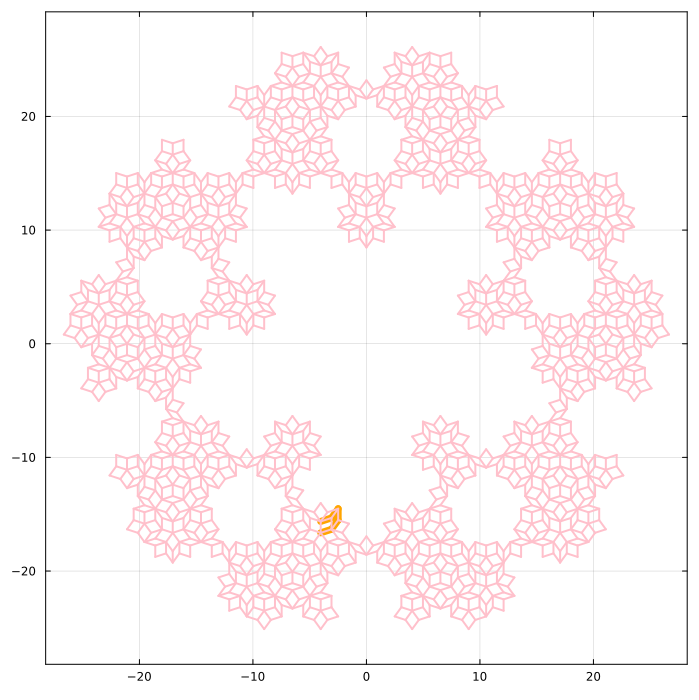

In [34]:
# Generate a single monomer path on the Penrose tiling
my_path = generate_monomer_path(100, get_nbrG(sub_penrose), 200)

# Set plot size (in pixels)
siz = 700
p = plot(size = (siz, siz), aspect_ratio = :equal, legend = false)
# Optional axis limits (can zoom into specific region if uncommented)
# xlim = (-25, -15), ylim = (-20, -15)

# Plot the generated monomer path on the Penrose lattice
plot_path(p, my_path, sub_penrose)

# Overlay the full Penrose graph edges for context
plot_edges(p, sub_penrose)

# Optional: save the plot to a file
# savefig(p, "./images/test_monomer_wilson_loop.png")

# Plot is built and ready; use `display(p)` to show it in notebook or script
display(p)

In [35]:
# Time how long it takes to generate a set of monomer basis paths on the Penrose graph
@time abasis = generate_mbasis(sub_penrose)

# Print the number of paths found for each loop length
println(length.(abasis))

  0.094497 seconds (474.56 k allocations: 17.579 MiB, 68.56% compilation time)
[2000, 824, 301, 175, 68, 37, 24, 18, 7]


In [36]:
# Initialize an empty list to store bulk (non-boundary) paths
bulkbasis = []

# Loop over all loop-length groups in the abasis
for i in 1:length(abasis)
    temp = []  # optional temporary list (currently unused)
    for j in 1:length(abasis[i])
        # Check if the j-th path in group i lies entirely in the bulk
        if boundary_path_check(abasis[i][j], sub_penrose_spin) == false
            # If so, add it to the final bulkbasis
            push!(bulkbasis, abasis[i][j])
        end
    end
end

In [37]:
# Save the `bulkbasis` data to a JLD file (commented out for now)
# File name includes metadata like `ngen`, `spin_origin`, and `run_no`
# save("./data/paths/monomer_paths_$ngen $spin_origin $run_no.jld", "bulkbasis", bulkbasis)

# Load `bulkbasis` back from a JLD file
# The file must exist and contain a variable named "bulkbasis"
# bulkbasis = load("./data/paths/monomer_paths_$ngen $spin_origin $run_no.jld")["bulkbasis"]
;

In [52]:
# Count how many times each path length occurs
length_counts = counter(length.(bulkbasis))

Accumulator{Int64, Int64} with 9 entries:
  4  => 728
  6  => 231
  16 => 4
  20 => 1
  10 => 26
  18 => 4
  12 => 7
  8  => 67
  14 => 5

In [39]:
# Convert paths to integer arrays (ensures uniform indexing type)
mfmnum_basis = convert_to_int(bulkbasis)

# Split each loop path into two halves
mfmnum_basis1 = [split_loop(lp)[1] for lp in mfmnum_basis]
mfmnum_basis2 = [split_loop(lp)[2] for lp in mfmnum_basis]

# Sanity check: ensure all loops are of even length
for i in 1:length(mfmnum_basis1)
    if isodd(length(mfmnum_basis1[i]) + length(mfmnum_basis2[i]))
        println("Loop length not even")
    end
end

# Convert spin paths into full 2D path matrices (each matrix is path × repetition index)
mfmnum1::Vector{Matrix{Int64}} = basis_path_to_all_path(mfmnum_basis1, sub_penrose_spin.pts)
mfmnum2::Vector{Matrix{Int64}} = basis_path_to_all_path(mfmnum_basis2, sub_penrose_spin.pts)

# Number of paths and their individual lengths
npath = length(mfmnum1)
lpath1 = [size(mfmnum1[i])[1] for i in 1:npath]
lpath2 = [size(mfmnum2[i])[1] for i in 1:npath]

# Print lengths of the two path halves
println([lpath1 lpath2])

# Group paths into a container
mfmpath = [mfmnum1, mfmnum2]

# Initialize the cap array, which stores the shared edge between paired path ends
cap = fill(0, 2, 10, npath)

# Compute the "cap" edges connecting the start and end spins of the two paths
for i in 1:npath
    for j in 1:10
        # Cap 1: between start of mfmnum1 and end of mfmnum2
        s1 = mfmnum1[i][1,j]
        s2 = mfmnum2[i][end,j]
        temp = intersect(sub_spins_to_edges[:,s1], sub_spins_to_edges[:,s2])
        if length(temp) == 1
            cap[1,j,i] = temp[1]
        else
            println("ERROR")  # If no shared edge exists
        end

        # Cap 2: between end of mfmnum1 and start of mfmnum2
        s1 = mfmnum1[i][end,j]
        s2 = mfmnum2[i][1,j]
        temp = intersect(sub_spins_to_edges[:,s1], sub_spins_to_edges[:,s2])
        if length(temp) == 1
            cap[2,j,i] = temp[1]
        else
            println("ERROR")
        end
    end
end

# This version DOES NOT filter paths based on coordination number.
println("Not conditioning the monomer paths on the coordination numbers")

# Initialize containers for all monomer paths and their caps (no filtering here)
clean_mfmnum1 = []
clean_mfmnum2 = []
clean_cap = []

# Simply collect all the original paths and caps
for i in 1:npath
    c1 = cap[1,1,i]
    c2 = cap[2,1,i]
    push!(clean_mfmnum1, mfmnum1[i])
    push!(clean_mfmnum2, mfmnum2[i])
    push!(clean_cap, cap[:,:,i])
end

# Update npath to reflect total number of unfiltered monomer paths
npath = length(clean_mfmnum1)

# Reconstruct the full `cap` array from saved values in `clean_cap`
cap = fill(0, 2, 10, npath)
for i in 1:npath
    for j in 1:10
        cap[2,j,i] = clean_cap[i][2,j]
        cap[1,j,i] = clean_cap[i][1,j]
    end
end

# Convert cleaned monomer paths into integer format if needed
mfmnum1 = convert_to_int(clean_mfmnum1)
mfmnum2 = convert_to_int(clean_mfmnum2)

# Store both monomer path halves together
mfmpath = [mfmnum1, mfmnum2]

# Record lengths of the paths (used for iteration later)
lpath1 = [size(mfmnum1[i])[1] for i in 1:npath]
lpath2 = [size(mfmnum2[i])[1] for i in 1:npath]
;

[2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2; 2 2;

path_length_counts = Accumulator(5 => 26, 4 => 67, 6 => 7, 7 => 5, 2 => 728, 10 => 1, 9 => 4, 8 => 4, 3 => 231)


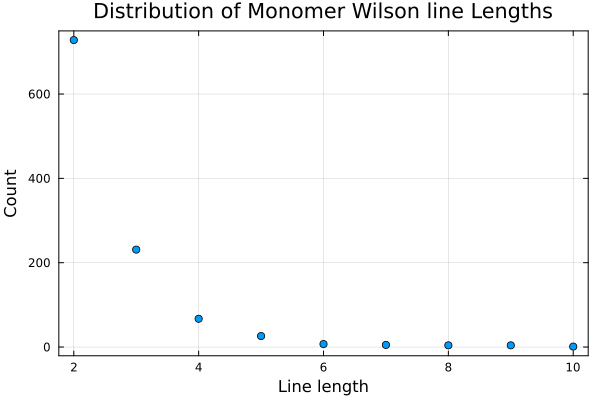

In [40]:
# Count how many times each path length appears
path_length_counts = counter(lpath1)

# Print the counts (optional)
@show path_length_counts

# Plot the histogram of path lengths using scatter
scatter(collect(keys(path_length_counts)), 
        collect(values(path_length_counts)), 
        xlabel = "Line length", ylabel = "Count", 
        title = "Distribution of Monomer Wilson line Lengths", 
        legend = false)


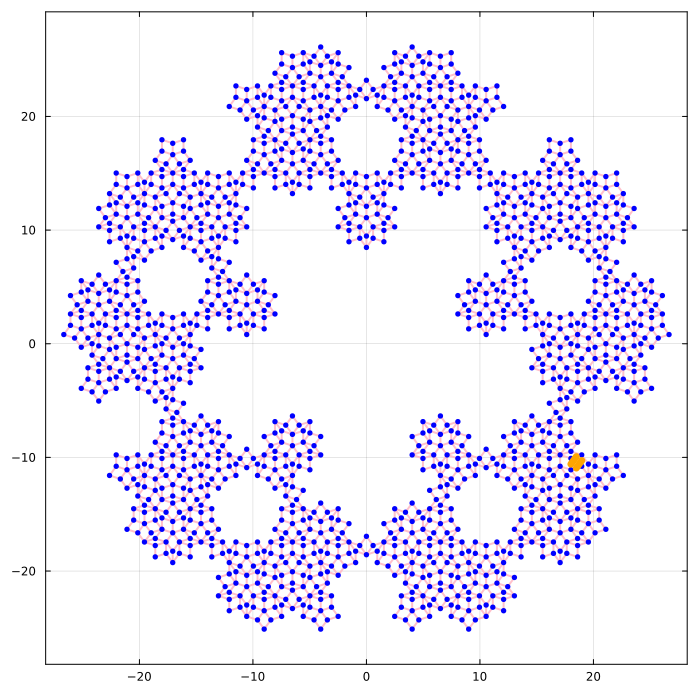

In [41]:
# Generate a base plot canvas of size 700×700
p = plot_generate(700)

# Plot all edges of the Penrose tiling in pink with linewidth 2
p = plot_edges(p, sub_penrose, "pink", 2)

# Plot all spin sites with a given marker size
p = plot_sites(p, sub_penrose; markersize = 3)

# Pick a random index between 1 and 8
i = rand(1:8)

# Plot the first half of the monomer path (mfmpath[1]) in the Penrose spin graph
p = plot_path(p, mfmpath[1][i][:,1], sub_penrose_spin)

# Plot the second half of the monomer path (mfmpath[2]) in the Penrose spin graph
p = plot_path(p, mfmpath[2][i][:,1], sub_penrose_spin)

display(p)

## 4.3 Vison Wilson loops and lines

In [43]:
function check_good_vison_path(path, plaq)
    nplaq = size(plaq)[1]
    visit = fill(0,nplaq)
    for pt in path
        for j in 1:nplaq
            if pt in plaq[j,:]
                visit[j] = visit[j] + 1
            end
        end
    end
    c = counter(visit)
    if c[1] != 2
        println("Error: More than 2 ones")
        return false
    elseif c[3] != 0
        println("Error: Three exists")
        return false
    elseif c[4] != 0
        println("Error: Four exists")
        return false
    end
    return true
end

function check_good_vison_loop(visit)
    c = counter(visit)
    if c[1] != 0
        println("Error: One exists")
        return false
    elseif c[3] != 0
        println("Error: Three exists")
        return false
    elseif c[4] != 0
        println("Error: Four exists")
        return false
    end
    return true
end

check_good_vison_loop (generic function with 1 method)

In [44]:
function generate_vfm_loop(
    l,                                 # Max length of the loop
    vison_spins_graph_nbr,             # Neighbor list for vison spins graph
    spin_to_plaq,                      # Mapping from spins to adjacent plaquettes
    cplaq,                             # Coordination number of each spin
    nspins,                            # Total number of spins
    nplaq,                             # Total number of plaquettes
    visit,                             # Preallocated vector for tracking plaquette visits
    Ntries = 100                       # Max number of attempts to extend/close the loop
)
    # Choose random starting spin and one of its neighbors
    start = rand(1:nspins)
    path = [start, rand(vison_spins_graph_nbr[start])]

    # Reject path if either of the first two spins lies on less than 2 plaquettes
    if cplaq[path[1]] < 2 || cplaq[path[2]] < 2
        return []
    end

    # Reset visit count for each plaquette
    fill!(visit, 0)

    # Increment visit count for plaquettes touching the first two spins
    for p in spin_to_plaq[path[1]]
        visit[p] += 1
    end
    for p in spin_to_plaq[path[2]]
        visit[p] += 1
    end

    counter = l  # Remaining allowed steps before giving up

    for _ in 1:Ntries
        current_pt = path[end]
        previous_pt = path[end-1]
        rnbr = shuffle(vison_spins_graph_nbr[current_pt])  # Randomize next step

        for next_pt in rnbr
            if next_pt != previous_pt
                if next_pt in path
                    # Found a loop — trace back to form the closed loop
                    push!(path, next_pt)
                    counter -= 1
                    temp = [pop!(path)]
                    while !isempty(path)
                        new_pt = pop!(path)
                        if new_pt == next_pt
                            return reverse(temp)  # Return cleaned-up loop
                        else
                            push!(temp, new_pt)
                        end
                    end
                    return []  # Should not hit this
                else
                    p = spin_to_plaq[next_pt]

                    # If spin doesn't lie on two plaquettes or already exceeded visit limit
                    if length(p) < 2 || visit[p[1]] > 1 || visit[p[2]] > 1
                        break
                    end

                    # Accept and move forward
                    push!(path, next_pt)
                    counter -= 1
                    visit[p[1]] += 1
                    visit[p[2]] += 1
                    break
                end
            end
        end

        if counter < 0
            return []  # Give up if loop grew too long
        end
    end

    return []  # Return empty if no loop closed in Ntries
end

function generate_vbasis(
    vison_spins_graph_nbr::Vector{Vector{Int}},  # Neighbor list for vison spins
    spin_to_plaq::Vector{Vector{Int}},           # Mapping from spin to adjacent plaquettes
    len                                          # Coordination number array cplaq
)
    Ncalls = 1000_000                               # Number of loop generation attempts
    result_list = []                             # Will store successful vison loops
    nspins = length(vison_spins_graph_nbr)       # Total number of spins
    nplaq = size(plaq)[1]                        # Total number of plaquettes
    visit = fill(0, nplaq)                       # Preallocated plaquette visit array

    for _ in 1:Ncalls
        # Try to generate a vison loop of length 100
        result = generate_vfm_loop(100, vison_spins_graph_nbr, spin_to_plaq, len, nspins, nplaq, visit)
        
        # Store successful loops only
        if result != []
            push!(result_list, result)
        end
    end

    # Return list of successful vison loops
    return [res for res in result_list]
end

generate_vbasis (generic function with 1 method)

In [45]:
function generate_vfnumbasis(vbasis, sub_penrose_spin)
    Npth = 110  # Max number of vison loops per valid loop length

    vfmnum_basis1 = []  # First half of vison loops (after splitting)
    vfmnum_basis2 = []  # Second half of vison loops

    # Count how many paths exist for each loop length
    cntr = counter(length.(vbasis))

    # Identify "good" lengths that appear more than Npth times
    good_length = [i for i in 4:maximum(length.(vbasis)) if cntr[i] > Npth]
    println("Selected loop lengths: ", good_length)

    acc = fill(0, maximum(length.(vbasis)))  # Accumulator to cap paths per length

    # Filter and split loops by length
    for i in 1:length(vbasis)
        lcurrpath = length(vbasis[i])
        if lcurrpath in good_length && acc[lcurrpath] < Npth
            pth1, pth2 = split_loop(vbasis[i])
            push!(vfmnum_basis1, pth1)
            push!(vfmnum_basis2, pth2)
            acc[lcurrpath] += 1

            # Sanity check: split path should match original length
            if length(pth1) + length(pth2) != lcurrpath
                println("Error: Split path length mismatch")
            end
        end
    end

    # Convert to int type if needed (assumes `cint` is an alias for convert_to_int)
    vfmnum_basis1 = cint(convert_to_int(vfmnum_basis1))
    vfmnum_basis2 = cint(convert_to_int(vfmnum_basis2))

    # Convert paths to matrix form: (steps × 10 repetitions) for each path
    vfmnum1::Vector{Matrix{Int64}} = basis_path_to_all_path(vfmnum_basis1, sub_penrose_spin.pts)
    vfmnum2::Vector{Matrix{Int64}} = basis_path_to_all_path(vfmnum_basis2, sub_penrose_spin.pts)

    # Number of valid vison loop paths
    npath = length(vfmnum1)

    # Record individual path lengths
    lpath1 = [size(vfmnum1[i])[1] for i in 1:npath]
    lpath2 = [size(vfmnum2[i])[1] for i in 1:npath]

    # Pack both sets of paths together for downstream use
    vfmpath = [vfmnum1, vfmnum2]

    return vfmnum_basis1, vfmnum_basis2, vfmpath, lpath1, lpath2, npath
end

# Convert a nested vector of numbers to a vector of Vector{Int64}
function cint(vec)
    temp = Vector{Vector{Int64}}(undef, length(vec))  # Preallocate outer container
    for i in 1:length(vec)
        inner = Vector{Int64}(undef, length(vec[i]))  # Preallocate each inner vector
        for j in 1:length(vec[i])
            inner[j] = vec[i][j]                      # Copy each element explicitly
        end
        temp[i] = inner
    end
    return temp
end

cint (generic function with 1 method)

In [46]:
# Step 1: Generate a list of valid vison loops
# - vison_spins_graph_nbr: neighbor list of spins
# - spin_to_plaq: maps each spin to the plaquettes it borders
# - length.(spin_to_plaq): gives the coordination number for each spin (used as `cplaq`)
@time vbasis = generate_vbasis(vison_spins_graph_nbr, convert_to_int(spin_to_plaq), length.(spin_to_plaq))

# Step 2: Process the raw vison loops into split paths and path matrices
# - Splits each valid loop into two parts
# - Converts them into matrices for sampling or measurement
vfmnum_basis1, vfmnum_basis2, vfmpath, lpath1, lpath2, npath = generate_vfnumbasis(vbasis, sub_penrose_spin)

# Step 3: Extract individual path matrices from vfmpath
vfmnum1, vfmnum2 = vfmpath
;

  5.219938 seconds (102.22 M allocations: 5.481 GiB, 6.58% gc time, 2.15% compilation time)
Selected loop lengths: [4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41]


In [47]:
# Save the vison path pair (vfmnum1, vfmnum2) as "vfmpath"
# Uses ngen and spin_origin to construct a unique filename
# Note: Uncomment to save
# save("./data/paper/vfm_paths_$(ngen)_$(spin_origin).jld", "vfmpath", vfmpath)

# Load the saved path pair
# This should match the variable name used during save ("vfmpath")
# vfmpath = load("./data/paper/vfm_paths_$(ngen)_$(spin_origin).jld")["vfmpath"]

# Unpack into the two parts of the vison loop basis
# vfmnum1, vfmnum2 = vfmpath

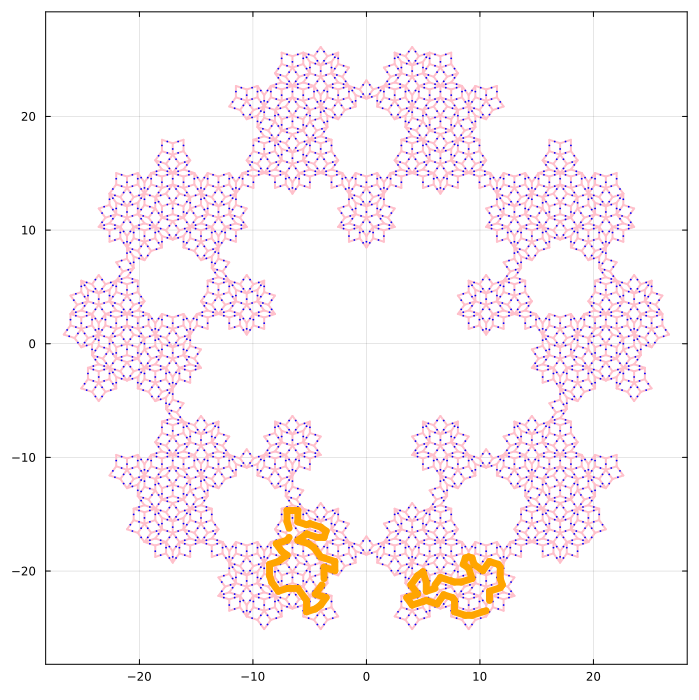

"/Users/jeet/umd/acad/projects/quasicrystals/penrose-dimer-monte-carlo/images/test_vison_wilson_loops.png"

In [48]:
# Set plot size (in pixels)
siz = 700

# Initialize plot with equal aspect ratio and no legend
p = plot(size = (siz, siz), aspect_ratio = :equal, legend = false)
# Optionally add: xlim = (5, 25), ylim = (-3, 20) if zooming in

# Plot the Penrose lattice edges
plot_edges(p, sub_penrose)

# Overlay spin sites in blue, with small markers
plot_sites(p, sub_penrose_spin, :blue, 0; annotate = false, markersize = 1)

# Choose column index j = 4 (i.e., the 4th randomly generated repetition for this path)
j = 4

# Loop over the last few vison paths (change range as needed)
for i in length(vfmnum1)-4 : length(vfmnum1)-3
    sub_plot_path(p, vfmnum1[i][:,j])  # Plot first half of loop
    sub_plot_path(p, vfmnum2[i][:,j])  # Plot second half of loop
end

display(p)
savefig(p, "./images/test_vison_wilson_loops.png")

All required paths have been generated. Now we do the Monte Carlo

# 5. Final Monte Carlo on a connected piece between monomer membranes

## 5.1 Sampling functions

In [ ]:
# === Accumulate matrix of ⟨Sz_i Sz_j⟩ correlators over all spin pairs (i < j) ===
function sz_correlator_mat(
    config::Vector{Int64},             # Current spin configuration (values ±1 or 0)
    running_sum::Matrix{Int64},        # Matrix accumulating correlator sums
    nspins::Int64                      # Total number of spins
)
    for origin in 1:nspins-1
        if config[origin] == 1
            # If spin i is +1, simply add Sz_j to correlator matrix
            for pt2 in origin+1:nspins
                running_sum[pt2, origin] += config[pt2]
            end
        else
            # If spin i is -1, subtract Sz_j (i.e., accumulate -Sz_i Sz_j)
            for pt2 in origin+1:nspins
                running_sum[pt2, origin] -= config[pt2]
            end 
        end
    end
end

# === Compute and accumulate vison correlators across all symmetric paths ===
function vis_partial(
    config::Vector{Int64},                         # Spin configuration
    running_sum::Vector{Matrix{Int64}},            # Running total for correlators
    npaths::Int64,                                 # Number of base paths
    lpath::Vector{Int64},                          # Length of each path
    mega_path::Vector{Matrix{Int64}}               # List of 10-symmetry-expanded paths per base path
)
    for i in 1:npaths
        for j in 1:10  # Loop over all 10 symmetric copies
            prod = config[mega_path[i][1, j]]  # Start with the first spin in path j
            for k in 2:lpath[i]
                prod *= config[mega_path[i][k, j]]  # Accumulate along the path
                running_sum[i][k, j] += prod        # Update running sum
            end
        end
    end
end

function vis_fm(
    config::Vector{Int64},               # Spin configuration (±1)
    num1::Matrix{Int64},                 # Accumulated parity for first path segment
    num2::Matrix{Int64},                 # Accumulated parity for second path segment
    den::Matrix{Int64},                  # Accumulated parity agreement (+1 or -1)
    vfmnum1::Vector{Matrix{Int64}},      # First half of vison paths (sites × 10)
    vfmnum2::Vector{Matrix{Int64}},      # Second half of vison paths
    npath::Int64,                        # Number of unique paths
    lpath1::Vector{Int64},               # Lengths of vfmnum1[i]
    lpath2::Vector{Int64}                # Lengths of vfmnum2[i]
)
    for i in 1:npath
        for j in 1:10
            # Compute the sign product (±1) along first vison path
            c1 = 1
            for k in 1:lpath1[i]
                if config[vfmnum1[i][k, j]] < 0
                    c1 = -c1
                end
            end
            num1[j, i] += c1

            # Repeat for second vison path
            c2 = 1
            for k in 1:lpath2[i]
                if config[vfmnum2[i][k, j]] < 0
                    c2 = -c2
                end
            end
            num2[j, i] += c2

            # Add to denominator based on sign agreement
            den[j, i] += (c1 == c2) ? 1 : -1
        end
    end
end

function mon_fm(
    config::Vector{Int64},
    num1::Matrix{Int64},                 # Counts for first monomer path
    num2::Matrix{Int64},                 # Counts for second monomer path
    den::Matrix{Int64},                  # Denominator: both paths alternating & endpoints different
    mfmnum1::Vector{Matrix{Int64}},      # First half of monomer paths
    mfmnum2::Vector{Matrix{Int64}},      # Second half of monomer paths
    npath::Int64,
    lpath1::Vector{Int64},
    lpath2::Vector{Int64},
    cap::Array{Int64, 3},                # cap[1/2, j, i]: two edges joining the halves
    sub_spin_nbr::Vector{Vector{Int64}}  # Spin neighbors for monomer detection
)
    for i in 1:npath
        for j in 1:10
            # --- Check if first half path is alternating ---
            alternating_path1 = true
            s1 = config[mfmnum1[i][1, j]]
            for k in 2:lpath1[i]
                s2 = config[mfmnum1[i][k, j]]
                if s1 == s2
                    alternating_path1 = false
                    break
                end
                s1 = s2
            end

            # If alternating, check if either endpoint is a monomer
            if alternating_path1
                monomer1 = ismonomer(config, cap[1, j, i], sub_spin_nbr)
                monomer2 = ismonomer(config, cap[2, j, i], sub_spin_nbr)
                if monomer1 || monomer2
                    num1[j, i] += 1
                end
            end

            # --- Repeat for second half path ---
            alternating_path2 = true
            s1 = config[mfmnum2[i][1, j]]
            for k in 2:lpath2[i]
                s2 = config[mfmnum2[i][k, j]]
                if s1 == s2
                    alternating_path2 = false
                    break
                end
                s1 = s2
            end

            if alternating_path2
                monomer1 = ismonomer(config, cap[1, j, i], sub_spin_nbr)
                monomer2 = ismonomer(config, cap[2, j, i], sub_spin_nbr)
                if monomer1 || monomer2
                    num2[j, i] += 1
                end
            end

            # --- Denominator update if both paths alternating and endpoints differ ---
            if alternating_path1 && alternating_path2
                if config[mfmnum1[i][1, j]] != config[mfmnum2[i][end, j]]
                    den[j, i] += 1
                end
            end
        end
    end
end

mon_fm (generic function with 1 method)

## 5.2 Main Monte Carlo function

In [50]:
function mc_mobile_sub_all(
    mc_steps::Int64,                  # Number of Monte Carlo steps
    Nmix::Int64,                      # Number of mixing (sweeps) between measurements
    config::Vector{Int64},           # Current spin configuration
    plaq_spins::Matrix{Int64},       # Spin indices on each plaquette
    npts::Int64,                     # Number of spin sites
    sub_spins_lat_mat::Matrix{Int64},# Lookup: [i,j] gives spin index between sites i and j
    nbr::Vector{Vector{Int64}},      # Neighbor list for each site
    paths::Vector{Vector{Int64}},    # Paths for vison correlator
    mega_path::Vector{Matrix{Int64}},# Vison correlator paths (longer)
    vfmpath::Vector{Vector{Matrix{Int64}}}, # Vison fractionalization paths (split loops)
    mfmpath::Vector{Vector{Matrix{Int64}}}, # Monomer fractionalization paths
    cap::Array{Int64, 3},            # Cap edges for monomer FM correlators
    sub_spin_nbr::Vector{Vector{Int64}}     # Neighbor spins for monomer check
)
    nplaq = size(plaq_spins, 1)
    nspins = length(config)

    # Initialize storage for observables
    sz_corr_array = fill(0, nspins, nspins)        # Sz-Sz correlator
    sz_avg = fill(0, nspins)                       # Average magnetization
    npaths = length(paths)
    lpath = length.(paths)
    vis_corr_array = [fill(0, lpath[i], lpath[i]) for i in 1:npaths]

    # Vison correlation matrix over "mega paths"
    nmegapaths = length(mega_path)
    lmegapath = [size(mega_path[i], 1) for i in 1:nmegapaths]
    vis_corr_array_2 = [fill(0, lmegapath[i], 10) for i in 1:nmegapaths]

    # Unpack vison FM paths
    vfmnum1, vfmnum2 = vfmpath
    vfmnpath = length(vfmnum1)
    vfmlpath1 = [size(vfmnum1[i], 1) for i in 1:vfmnpath]
    vfmlpath2 = [size(vfmnum2[i], 1) for i in 1:vfmnpath]
    num1 = fill(0, 10, vfmnpath)
    num2 = fill(0, 10, vfmnpath)
    den  = fill(0, 10, vfmnpath)

    # Unpack monomer FM paths
    mfmnum1, mfmnum2 = mfmpath
    mnpath = length(mfmnum1)
    m_lpath1 = [size(mfmnum1[i], 1) for i in 1:mnpath]
    m_lpath2 = [size(mfmnum2[i], 1) for i in 1:mnpath]
    m_num1 = fill(0, 10, mnpath)
    m_num2 = fill(0, 10, mnpath)
    m_den  = fill(0, 10, mnpath)

    # Monte Carlo sampling loop
    for i in 1:mc_steps
        for j in 1:Nmix
            monomer_move(config, npts, sub_spins_lat_mat, nbr)
        end

        # Accumulate observables
        sz_avg .+= config
        sz_correlator_mat(config, sz_corr_array, nspins)
        vis_partial(config, vis_corr_array_2, nmegapaths, lmegapath, mega_path)
        vis_fm(config, num1, num2, den, vfmnum1, vfmnum2, vfmnpath, vfmlpath1, vfmlpath2)
        mon_fm(config, m_num1, m_num2, m_den, mfmnum1, mfmnum2, mnpath, m_lpath1, m_lpath2, cap, sub_spin_nbr)
    end

    # Normalize observables by number of samples
    sz_corr_array_float = sz_corr_array / mc_steps
    sz_avg_float = sz_avg / mc_steps
    vis_corr_array_float = vis_corr_array_2 / mc_steps
    vfm_arr_float = [num1, num2, den] ./ mc_steps
    mfm_arr_float = [m_num1, m_num2, m_den] ./ mc_steps

    # Return all processed observables and final configuration
    return sz_avg_float, (sz_corr_array_float + sz_corr_array_float') + I, vis_corr_array_float, vfm_arr_float, mfm_arr_float, config
end

mc_mobile_sub_all (generic function with 1 method)

In [51]:
# Record start time for total run duration
t_start = now()

# -----------------------------------
# Monte Carlo Parameters
# -----------------------------------
mc_steps = 2000      # Number of Monte Carlo steps (e.g., 2_000_000 in cluster runs)
Nmix = 500           # Number of mixing sweeps between measurements

# -----------------------------------
# Initialize spin configuration
# `max_match` refers to initial dimer matching
sub_config = get_sub_config(reset_config(max_match))

println("Starting the main Monte Carlo run...")

# -----------------------------------
# Run the Monte Carlo simulation
# Measures spin and vison observables, FM indicators, and returns the updated config
@time sz1, szsz1, vison1, vfm_arr, mfm_arr, sub_config1 = mc_mobile_sub_all(
    mc_steps,
    Nmix,
    sub_config,
    sub_penrose_spin.plaq,
    sub_npts,
    sub_spins_lat_mat,
    get_sub_neighbors(sub_penrose),
    paths,
    mega_path,
    vfmpath,
    mfmpath,
    cap,
    convert_to_int(sub_spin_nbr)
)

# -----------------------------------
# Package data for optional saving
# data_to_save[1]: Output observables
# data_to_save[2]: All inputs and parameters needed to re-run or analyze
data_to_save = [
    [sz1, szsz1, vison1, vfm_arr, mfm_arr],
    [mc_steps, Nmix, sub_config, sub_penrose_spin.plaq, sub_npts,
     sub_spins_lat_mat, get_sub_neighbors(sub_penrose),
     paths, mega_path, vfmpath, mfmpath, cap, sub_spin_nbr]
]

# -----------------------------------
# Optional: Save results
# save("./data/mc_data/run_$runno.jld", "data_to_save", data_to_save)
# println("Data saved successfully.")

# -----------------------------------
# Print total time taken in minutes
t_end = now()
println("Time taken = ", (t_end - t_start).value / 60_000, " minutes")

Starting the main Monte Carlo run...
 10.490462 seconds (17.33 k allocations: 237.143 MiB, 2.39% gc time)
Time taken = 0.18673333333333333 minutes


The saved data will be used in another notebook to perform the analysis and make plots

# 6. Extra code

In [ ]:

# # === Fill in the upper triangle of vison correlator matrices by symmetry ===
# function symmetrise_vison(
#     vison::Vector{Matrix{Float64}},                # Final vison correlator matrices
#     lpath::Vector{Int64},                          # Path length vector
#     npaths::Int64                                  # Number of base paths
# )
#     for i in 1:npaths
#         for j in 1:lpath[i]-1
#             for k in j+1:lpath[i]
#                 vison[i][j, k] = vison[i][k, j]  # Enforce symmetry: M[j,k] = M[k,j]
#             end
#             vison[i][j, j] = 1.0  # Diagonal: spin perfectly correlated with itself
#         end
#         vison[i][lpath[i], lpath[i]] = 1.0
#     end
# end



In [ ]:
# CHECK
# function post_process_vfm(vfm_arr, vfmpath)
#     cbin = []
#     fmbin = []
#     dbin = []
#     ebin = []

#     num1, num2, den = vfm_arr
#     num_path1, num_path2 = vfmpath
#     fm = sqrt.( abs.(num1 .* num2 ./ den) )
#     println(size(fm))
#     mean1, mean2, mean_den, mean_fm = mean(abs.(num1), dims=1), mean(abs.(num2), dims=1), mean(abs.(den), dims=1), mean(fm, dims=1)
#     # std_fm = std(fm, dims=1)
#     disnum = []
#     cnum = [] 
#     # cnum1 = []
#     # cnum2 = []
#     disden = []
#     cden = []

#     for i in 1:length(num_path1)
#         push!(disnum, size(num_path1[i])[1])
#         # push!(cnum1, mean1[1,i])
#         push!(cnum, mean1[1,i])
#         push!(disnum, size(num_path2[i])[1])
#         # push!(cnum2, mean2[1,i])
#         push!(cnum, mean2[1,i])

#         push!(disden, size(num_path1[i])[1]+ size(num_path2[i])[1])
#         push!(cden, mean_den[1,i])
#     end
#     return disnum, cnum,  disden, cden
#     # return disnum, cnum1, cnum2,  disden, cden
# end

# function post_process_vfm_asymmetric(vfm_arr, vfmpath)
#     cbin = []
#     fmbin = []
#     dbin = []
#     ebin = []

#     num1, num2, den = vfm_arr
#     num_path1, num_path2 = vfmpath
#     fm =  sqrt.( abs.(num1 .* num2 ./ den) )
#     println(size(fm))
#     # mean1, mean2, mean_den, mean_fm = mean(abs.(num1), dims=1), mean(abs.(num2), dims=1), mean(abs.(den), dims=1), mean(fm, dims=1)
#     # std_fm = std(fm, dims=1)
#     disnum = []
#     cnum = [] 
#     cnum1 = []
#     cnum2 = []
#     disden = []
#     cden = []
#     dis = []
#     c = []

#     for i in 1:length(num_path1)
#         for j in 1:10
#             # push!(disnum, size(num_path1[i])[1])
#             # # push!(cnum1, mean1[1,i])
#             # push!(cnum, num1[j,i])
#             # push!(disnum, size(num_path2[i])[1])
#             # # push!(cnum2, mean2[1,i])
#             # push!(cnum, num2[j,i])

#             # push!(disnum, size(num_path1[i])[1])
#             push!(cnum1, num1[j,i] )
#             # push!(disnum, size(num_path2[i])[1])
#             push!(cnum2, num2[j,i] )

#             push!(disden, size(num_path1[i])[1]+ size(num_path2[i])[1])
#             push!(cden, den[j,i])

#             push!(dis, size(num_path1[i])[1]+ size(num_path2[i])[1])
#             push!(c, sqrt( abs( num1[j,i] * num2[j,i] / den[j,i])) )
#             # push!(c, fm[j,i])
#         end
#     end
#     # return dis, abs.(c), disnum, abs.(cnum),  disden, abs.(cden)
#     return dis, abs.(c), disden, abs.(cnum1), abs.(cnum2), abs.(cden)
# end

# function post_process_vfm_euclidean(vfm_arr, vfmpath, sub_penrose_spin)
#     cbin = []
#     fmbin = []
#     dbin = []
#     ebin = []

#     num1, num2, den = vfm_arr
#     num_path1, num_path2 = vfmpath
#     fm = sqrt.( abs.(num1 .* num2 ./ den) )
#     println(size(fm))
#     mean1, mean2, mean_den, mean_fm = mean(abs.(num1), dims=1), mean(abs.(num2), dims=1), mean(abs.(den), dims=1), mean(fm, dims=1)
#     # std_fm = std(fm, dims=1)
#     disnum = []
#     cnum = [] 
#     # cnum1 = []
#     # cnum2 = []
#     disden = []
#     cden = []
#     pts = sub_penrose_spin.pts

#     for i in 1:length(num_path1)
#         p_start1 = num_path1[i][1,1]
#         p_end1 = num_path1[i][end,1]
#         d1 = abs(pts[p_start1] - pts[p_end1])
#         push!(disnum, d1)
#         push!(cnum, mean1[1,i])

#         p_start2 = num_path2[i][1,1]
#         p_end2 = num_path2[i][end,1]
#         d2 = abs(pts[p_start2] - pts[p_end2])
#         push!(disnum, d2)
#         push!(cnum, mean2[1,i])

#         push!(disden, (d1+d2)/2)
#         push!(cden, mean_den[1,i])
#     end
#     return disnum, cnum,  disden, cden
#     # return disnum, cnum1, cnum2,  disden, cden
# end


# function post_process_vfm_ratio(vfm_arr, vfmpath, sub_penrose_spin)
#     num1, num2, den = vfm_arr
#     num_path1, num_path2 = vfmpath
#     # println(size(fm))
#     mean1, mean2, mean_den = mean(abs.(num1), dims=1), mean(abs.(num2), dims=1), mean(abs.(den), dims=1)
#     println(size(mean1), "\t sadfasd")
#     fm =  abs.(mean1 .* mean2 ./ mean_den) 
#     dis  = []
#     c = []
#     disnum = []
#     cnum = [] 
#     disden = []
#     cden = []

#     pts = sub_penrose_spin.pts
#     println(size(fm), "\t size fm")

#     for i in 1:length(num_path1)
#         push!(disnum, size(num_path1[i])[1])
#         # push!(cnum1, mean1[1,i])
#         push!(cnum, mean1[1,i])
#         push!(disnum, size(num_path2[i])[1])
#         # push!(cnum2, mean2[1,i])
#         push!(cnum, mean2[1,i])

#         push!(disden, size(num_path1[i])[1]+ size(num_path2[i])[1])
#         push!(cden, mean_den[1,i])

#         push!(c, fm[1,i])
#         push!(dis, size(num_path1[i])[1]+ size(num_path2[i])[1])
#     end

#     return dis,  c, disnum, cnum, disden, cden
#     # return disnum, cnum1, cnum2,  disden, cden
# end

In [ ]:
# CHECK
# function post_process_mfm(mfm_arr, mfmpath)
#     mfmnum1, mfmnum2 = mfmpath
#     mat = (mfm_arr[1] .* mfm_arr[2] ./ mfm_arr[3])
#     num1 = []
#     num2 = []
#     den = []
#     corr = []
#     dist = []
#     npath = size(mfm_arr[1])[2]
#     for i in 1:npath
#         n1 = mean(mfm_arr[1][:,i])
#         n2 = mean(mfm_arr[2][:,i])
#         de = mean(mfm_arr[3][:,i])
#         push!(num1, n1)
#         push!(num2, n2)
#         push!(den, de)
#         push!(dist, size(mfmpath[1][i])[1] + size(mfmpath[2][i])[1])
#         push!(corr, n1*n2/de)
#     end
#     return dist, num1, num2, den, corr
# end

In [ ]:
# CHECK
# # Lightweight post-processing function that extracts vison correlators and distances between points on each path
# function post_process_vison_lite(vison, paths)
#     distance = []     # Stores distances between points
#     vis_vector = []   # Stores corresponding vison correlator magnitudes
#     for i in 1:length(paths)
#         current_path = paths[i]
#         for j in 1:length(current_path)-1
#             for k in j+1:length(current_path)
#                 # Compute distance between two points along the path
#                 push!(distance, abs(sub_spins_pos[current_path[j]] - sub_spins_pos[current_path[k]]))
#                 # Store the absolute value of the vison correlator between those two points
#                 push!(vis_vector, abs(vison[i][j,k]))
#             end
#         end
#     end
#     return distance, vis_vector
# end

# # Full post-processing with binning/averaging of vison correlators based on distance
# function post_process_vison(vison, paths; averaging_radius = 0.4)    
#     distance = []     # Raw distances between pairs of points along paths
#     vis_vector = []   # Raw vison correlator values

#     # Step 1: Compute all pairwise distances and vison correlators
#     for i in 1:length(paths)
#         current_path = paths[i]
#         for j in 1:length(current_path)-1
#             for k in j+1:length(current_path)
#                 push!(distance, abs(sub_spins_pos[current_path[j]] - sub_spins_pos[current_path[k]]))
#                 push!(vis_vector, abs(vison[i][j,k]))
#             end
#         end
#     end

#     clean_dist = []             # Binned distance values (representative of each bin)
#     clean_vis = []              # Averaged vison correlators for each bin
#     visited = fill(0, length(distance))  # Tracks whether a point has been assigned to a bin

#     # Step 2: Group close distances and average their vison values
#     for i in 1:length(distance)
#         if visited[i] == 1 
#             continue
#         end
#         push!(clean_dist, distance[i])  # Use current distance as representative of this bin
#         temp = []
#         for j in 1:length(distance)
#             if abs(distance[i] - distance[j]) < averaging_radius && visited[j] == 0
#                 push!(temp, vis_vector[j])  # Collect all vison values in the bin
#                 visited[j] = 1              # Mark them as visited
#             end
#         end
#         push!(clean_vis, mean(temp))       # Store the averaged vison value for this bin
#         if i == 1
#             println(length(temp))          # Print the size of the first bin for debugging
#         end
#     end

#     # Step 3: Plot the log of vison correlators against distance
#     display(scatter(clean_dist, log.(clean_vis)))
#     return clean_dist, clean_vis
# end

In [ ]:
# CHECK
# # === Compute and accumulate vison correlator products along direct paths ===
# function vis(
#     sub_config::Vector{Int64},                     # Current spin configuration
#     running_sum::Vector{Matrix{Int64}},            # Accumulator for correlator values
#     npaths::Int64,                                 # Number of paths
#     lpath::Vector{Int64},                          # Length of each path
#     paths::Vector{Vector{Int64}}                   # List of paths (one per entry)
# )
#     for i in 1:npaths
#         for j in 1:lpath[i]-1
#             prod = sub_config[paths[i][j]]  # Start accumulating from spin j
#             for k in j+1:lpath[i]
#                 prod *= sub_config[paths[i][k]]  # Multiply spin values along the path
#                 running_sum[i][k, j] += prod     # Accumulate product for (j,k) pair
#             end
#         end
#     end
# end
